#  GAN

__Автор задач: Блохин Н.В. (NVBlokhin@fa.ru)__

Материалы:
* https://pytorch.org/tutorials/beginner/dcgan_faces_tutorial.html
* https://www.kaggle.com/datasets/splcher/animefacedataset
* https://github.com/eriklindernoren/PyTorch-GAN

## Задачи для совместного разбора

1\. Обсудите основные шаги в обучении GAN.

## Задачи для самостоятельного решения

In [ ]:
import torch
import torch.nn as nn
import torch.optim as optim
from torch.utils.data import Dataset, DataLoader
import torchvision
import torchvision.transforms as transforms
import torchvision.utils as vutils
import matplotlib.pyplot as plt
import numpy as np
import os
from PIL import Image
import glob
import random
import zipfile

In [ ]:
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
device

device(type='cuda')

<p class="task" id="1"></p>

1\. Создайте набор данных на основе датасета `animefacedataset`. Используя преобразования `torchvision`, приведите изображения к одному размеру и нормализуйте их. Выведите на экран несколько примеров изображений.

- [ ] Проверено на семинаре

In [ ]:
image_size = 64
batch_size = 128

In [ ]:
archive_path = "archive.zip"
extract_root = "animefacedataset"
images_dir = os.path.join(extract_root, "images")

In [ ]:
if not os.path.exists(images_dir):
    with zipfile.ZipFile(archive_path, "r") as zf:
        zf.extractall(extract_root)

In [ ]:
anime_dataroot = images_dir

In [ ]:
transform = transforms.Compose([
    transforms.Resize(image_size),
    transforms.CenterCrop(image_size),
    transforms.ToTensor(),
    transforms.Normalize((0.5, 0.5, 0.5),
                         (0.5, 0.5, 0.5))
])

In [ ]:
class AnimeDataset(Dataset):
    def __init__(self, img_dir, transform=None):
        self.img_dir = img_dir
        self.transform = transform
        self.files = sorted(glob.glob(os.path.join(img_dir, "*.jpg")))

    def __len__(self):
        return len(self.files)

    def __getitem__(self, idx):
        img = Image.open(self.files[idx]).convert("RGB")
        if self.transform:
            img = self.transform(img)
        return img

In [ ]:
anime_dataset = AnimeDataset(img_dir=images_dir, transform=transform)
anime_loader = DataLoader(anime_dataset, batch_size=batch_size, shuffle=True, num_workers=2)

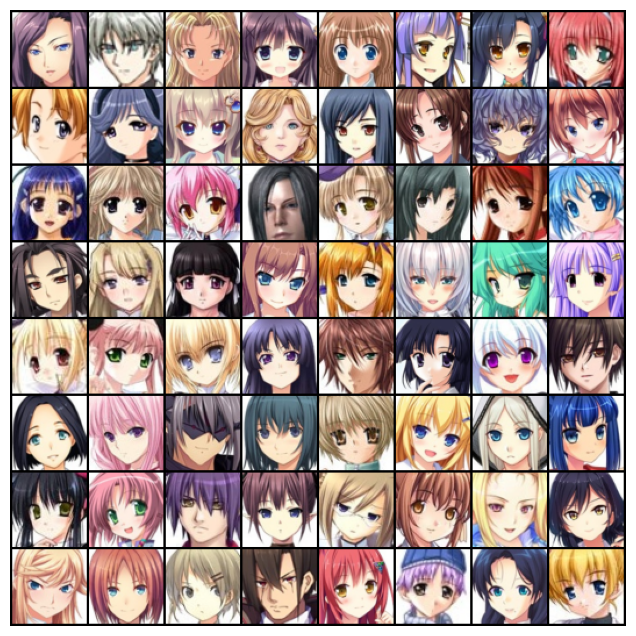

In [ ]:
real_batch = next(iter(anime_loader))
plt.figure(figsize=(8, 8))
plt.axis("off")
grid = vutils.make_grid(real_batch.to(device)[:64], nrow=8, padding=2, normalize=True)
plt.imshow(np.transpose(grid.cpu(), (1, 2, 0)))
plt.show()

<p class="task" id="2"></p>

2\. Реализуйте архитектуру `DCGAN` и обучите модель. Подберите гиперпараметры таким образом, чтобы получаемые изображения стали достаточного качественными (четкими и без существенных дефектов). Во время обучения сохраняйте примеры генерации изображений из случайного шума и сравните, как менялось качество получаемых изображений в процессе обучения.

- [ ] Проверено на семинаре

In [ ]:
def weights_init(m):
    classname = m.__class__.__name__
    if classname.find('Conv') != -1:
        nn.init.normal_(m.weight.data, 0.0, 0.02)
    elif classname.find('BatchNorm') != -1:
        nn.init.normal_(m.weight.data, 1.0, 0.02)
        nn.init.constant_(m.bias.data, 0)

In [ ]:
class Generator(nn.Module):
    def __init__(self, nz=100, ngf=64, nc=3):
        super(Generator, self).__init__()
        self.main = nn.Sequential(
            nn.ConvTranspose2d(nz, ngf * 8, 4, 1, 0, bias=False),
            nn.BatchNorm2d(ngf * 8),
            nn.ReLU(True),

            nn.ConvTranspose2d(ngf * 8, ngf * 4, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ngf * 4),
            nn.ReLU(True),

            nn.ConvTranspose2d(ngf * 4, ngf * 2, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ngf * 2),
            nn.ReLU(True),

            nn.ConvTranspose2d(ngf * 2, ngf, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ngf),
            nn.ReLU(True),

            nn.ConvTranspose2d(ngf, nc, 4, 2, 1, bias=False),
            nn.Tanh() #
        )

    def forward(self, input):
        return self.main(input)

In [ ]:
class Discriminator(nn.Module):
    def __init__(self, ndf=64, nc=3):
        super(Discriminator, self).__init__()
        self.main = nn.Sequential(
            nn.Conv2d(nc, ndf, 4, 2, 1, bias=False),
            nn.LeakyReLU(0.2, inplace=True),
            nn.Conv2d(ndf, ndf * 2, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ndf * 2),
            nn.LeakyReLU(0.2, inplace=True),

            nn.Conv2d(ndf * 2, ndf * 4, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ndf * 4),
            nn.LeakyReLU(0.2, inplace=True),

            nn.Conv2d(ndf * 4, ndf * 8, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ndf * 8),
            nn.LeakyReLU(0.2, inplace=True),

            nn.Conv2d(ndf * 8, 1, 4, 1, 0, bias=False),
            nn.Sigmoid()
        )

    def forward(self, input):
        return self.main(input)

In [ ]:
netG = Generator().to(device)
netG.apply(weights_init)
netD = Discriminator().to(device)
netD.apply(weights_init)

Discriminator(
  (main): Sequential(
    (0): Conv2d(3, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (1): LeakyReLU(negative_slope=0.2, inplace=True)
    (2): Conv2d(64, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (3): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (4): LeakyReLU(negative_slope=0.2, inplace=True)
    (5): Conv2d(128, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (6): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (7): LeakyReLU(negative_slope=0.2, inplace=True)
    (8): Conv2d(256, 512, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (9): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (10): LeakyReLU(negative_slope=0.2, inplace=True)
    (11): Conv2d(512, 1, kernel_size=(4, 4), stride=(1, 1), bias=False)
    (12): Sigmoid()
  )
)

In [ ]:
criterion = nn.BCELoss()
fixed_noise = torch.randn(64, 100, 1, 1, device=device)
optimizerD = optim.Adam(netD.parameters(), lr=0.0002, betas=(0.5, 0.999))
optimizerG = optim.Adam(netG.parameters(), lr=0.0002, betas=(0.5, 0.999))
num_epochs = 15

[0/15][0/497] Loss_D: 2.1320 Loss_G: 2.8718
[0/15][100/497] Loss_D: 0.6167 Loss_G: 6.2533
[0/15][200/497] Loss_D: 1.1127 Loss_G: 15.5459
[0/15][300/497] Loss_D: 0.5524 Loss_G: 5.4319
[0/15][400/497] Loss_D: 0.1462 Loss_G: 5.9807


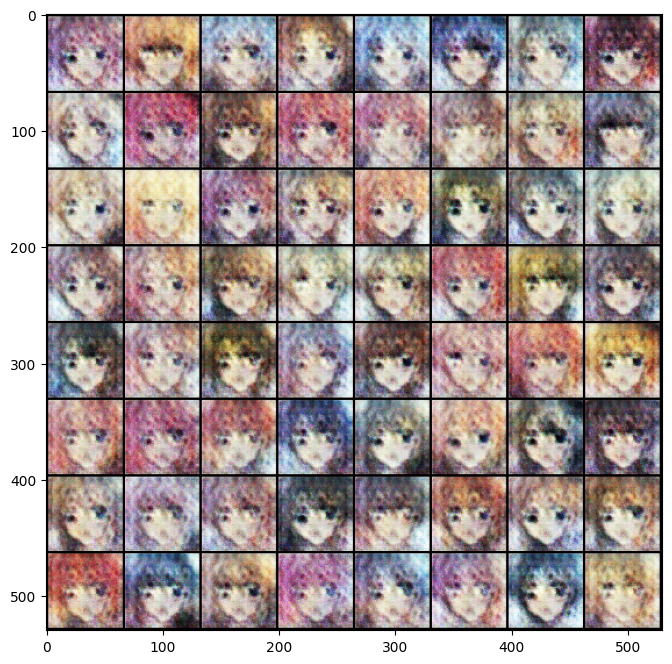

[1/15][0/497] Loss_D: 0.3970 Loss_G: 5.3101
[1/15][100/497] Loss_D: 0.9879 Loss_G: 5.7775
[1/15][200/497] Loss_D: 1.2938 Loss_G: 9.6990
[1/15][300/497] Loss_D: 0.6802 Loss_G: 7.4841
[1/15][400/497] Loss_D: 0.6986 Loss_G: 7.6839


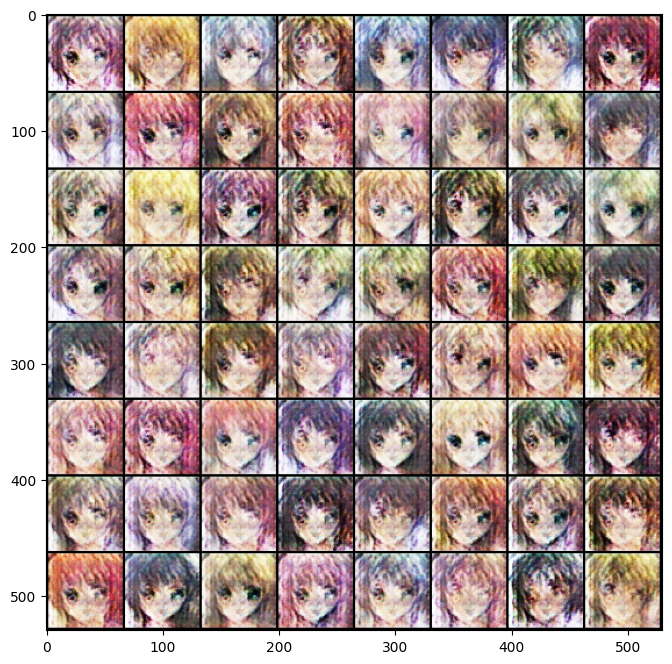

[2/15][0/497] Loss_D: 0.6605 Loss_G: 8.4916
[2/15][100/497] Loss_D: 1.1968 Loss_G: 10.9628
[2/15][200/497] Loss_D: 0.4653 Loss_G: 5.2490
[2/15][300/497] Loss_D: 0.1575 Loss_G: 3.5031
[2/15][400/497] Loss_D: 0.3801 Loss_G: 6.2496


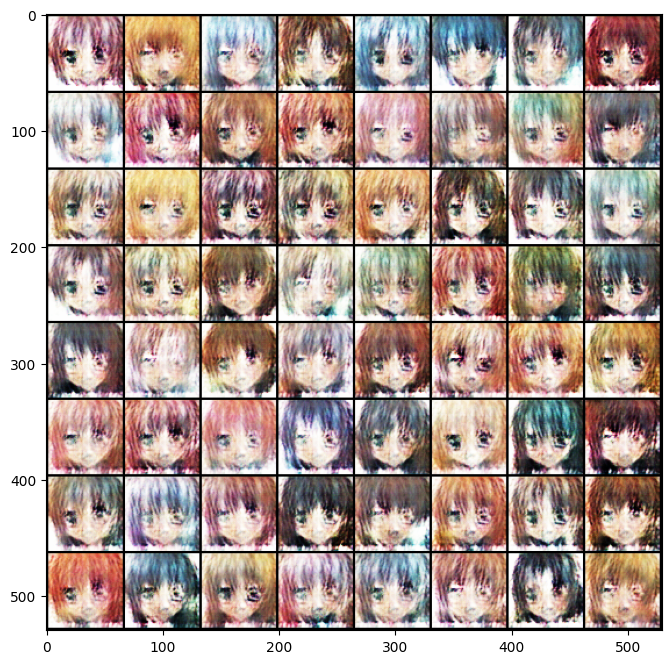

[3/15][0/497] Loss_D: 0.1381 Loss_G: 3.7646
[3/15][100/497] Loss_D: 0.4781 Loss_G: 5.4007
[3/15][200/497] Loss_D: 0.3662 Loss_G: 6.9251
[3/15][300/497] Loss_D: 0.2475 Loss_G: 5.5825
[3/15][400/497] Loss_D: 0.3517 Loss_G: 5.5525


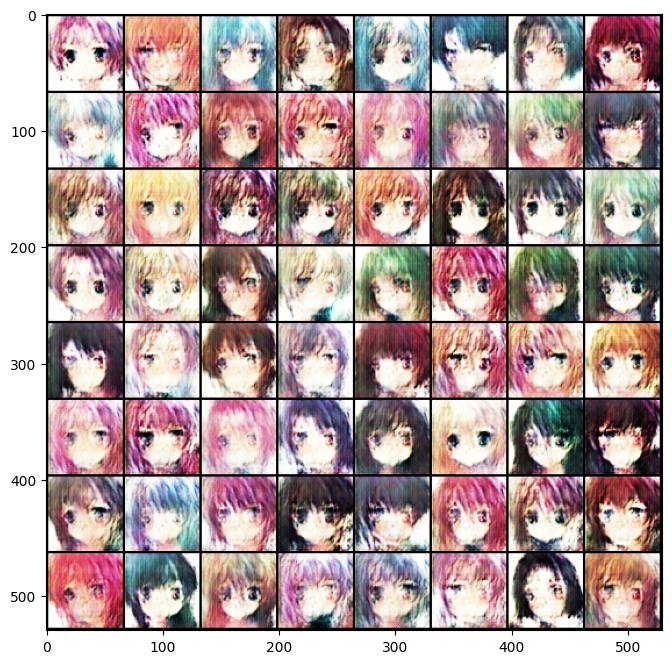

[4/15][0/497] Loss_D: 0.3565 Loss_G: 6.5094
[4/15][100/497] Loss_D: 0.2790 Loss_G: 5.6688
[4/15][200/497] Loss_D: 2.0262 Loss_G: 4.0344
[4/15][300/497] Loss_D: 0.2362 Loss_G: 5.3419
[4/15][400/497] Loss_D: 0.2098 Loss_G: 5.2425


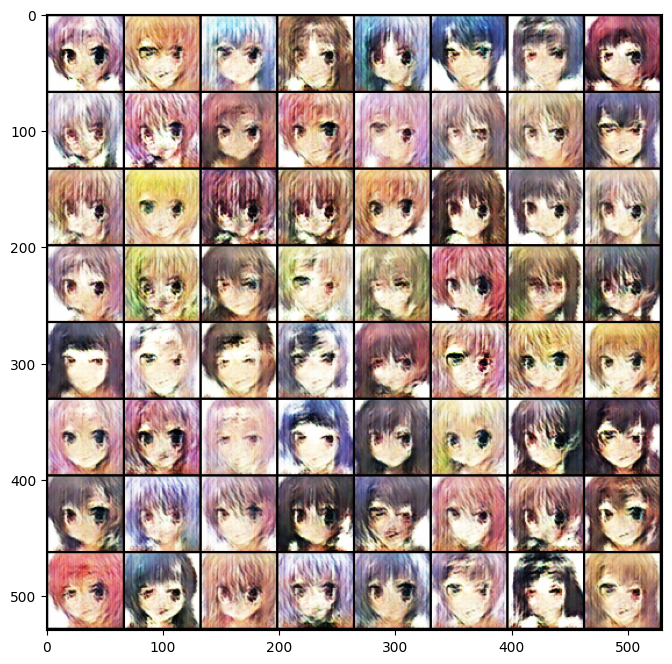

[5/15][0/497] Loss_D: 1.5905 Loss_G: 2.5515
[5/15][100/497] Loss_D: 0.4200 Loss_G: 4.0239
[5/15][200/497] Loss_D: 0.1558 Loss_G: 6.0295
[5/15][300/497] Loss_D: 1.1670 Loss_G: 3.4563
[5/15][400/497] Loss_D: 0.5000 Loss_G: 8.7081


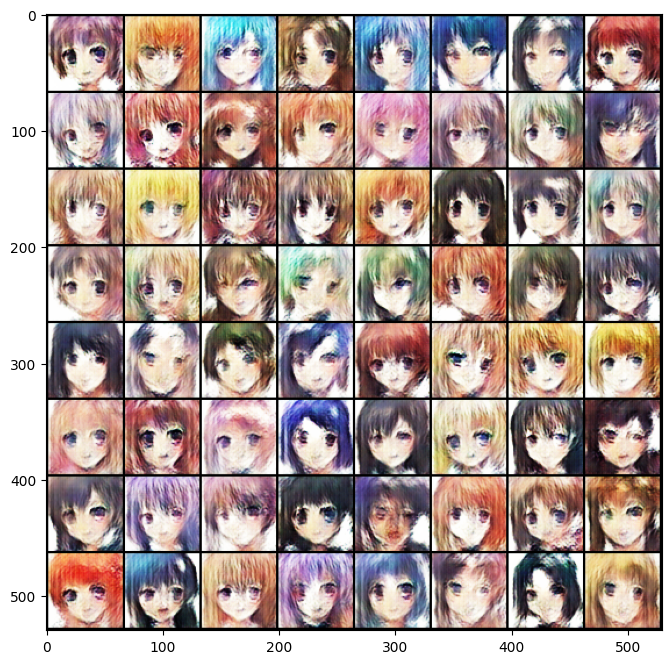

[6/15][0/497] Loss_D: 0.3864 Loss_G: 5.0000
[6/15][100/497] Loss_D: 0.5844 Loss_G: 8.0483
[6/15][200/497] Loss_D: 0.7381 Loss_G: 2.1869
[6/15][300/497] Loss_D: 0.4083 Loss_G: 4.8445
[6/15][400/497] Loss_D: 0.2036 Loss_G: 3.8528


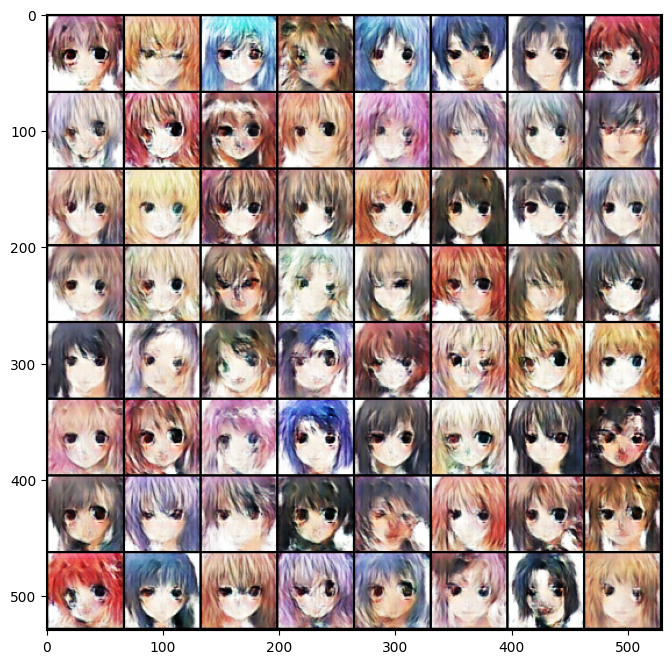

[7/15][0/497] Loss_D: 0.3493 Loss_G: 3.5655
[7/15][100/497] Loss_D: 0.4070 Loss_G: 6.3056
[7/15][200/497] Loss_D: 0.2478 Loss_G: 4.4854
[7/15][300/497] Loss_D: 0.4928 Loss_G: 7.3116
[7/15][400/497] Loss_D: 0.0660 Loss_G: 3.2972


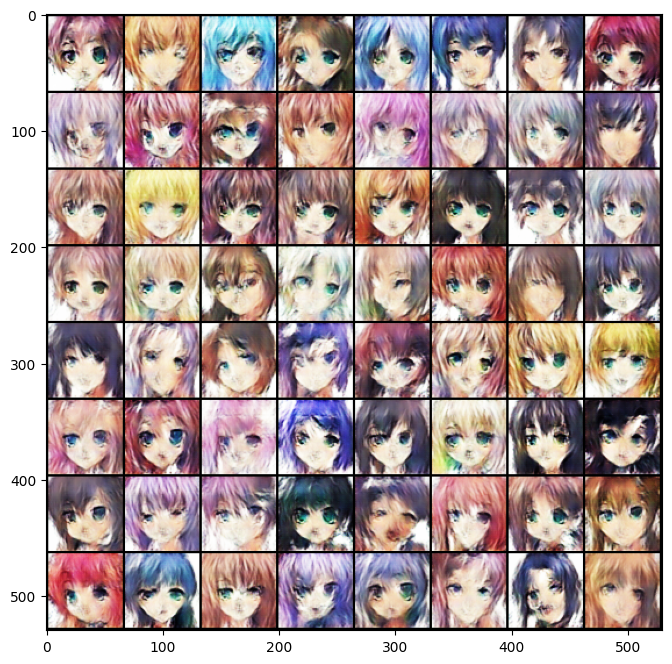

[8/15][0/497] Loss_D: 0.2813 Loss_G: 4.0047
[8/15][100/497] Loss_D: 0.3966 Loss_G: 3.1937
[8/15][200/497] Loss_D: 0.5831 Loss_G: 3.9168
[8/15][300/497] Loss_D: 0.3157 Loss_G: 4.5612
[8/15][400/497] Loss_D: 0.3382 Loss_G: 4.3455


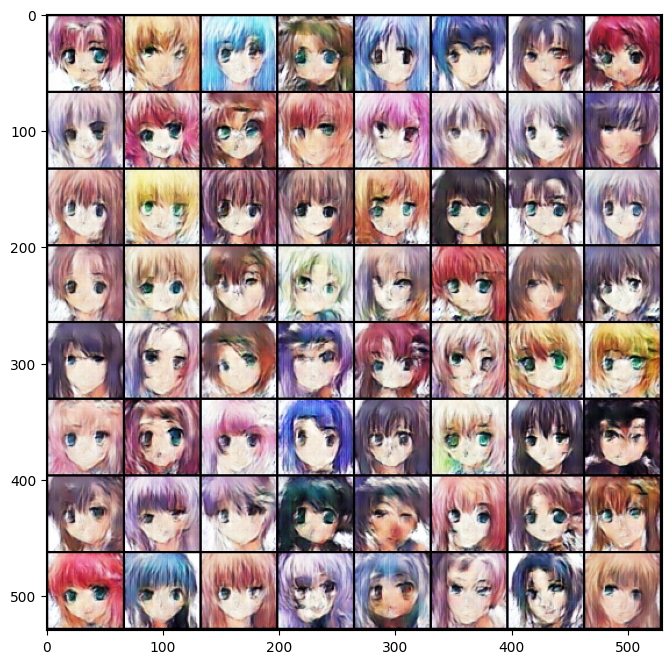

[9/15][0/497] Loss_D: 4.0298 Loss_G: 1.4764
[9/15][100/497] Loss_D: 0.5100 Loss_G: 6.1738
[9/15][200/497] Loss_D: 0.7504 Loss_G: 8.0902
[9/15][300/497] Loss_D: 3.4683 Loss_G: 6.5100
[9/15][400/497] Loss_D: 0.2892 Loss_G: 5.0660


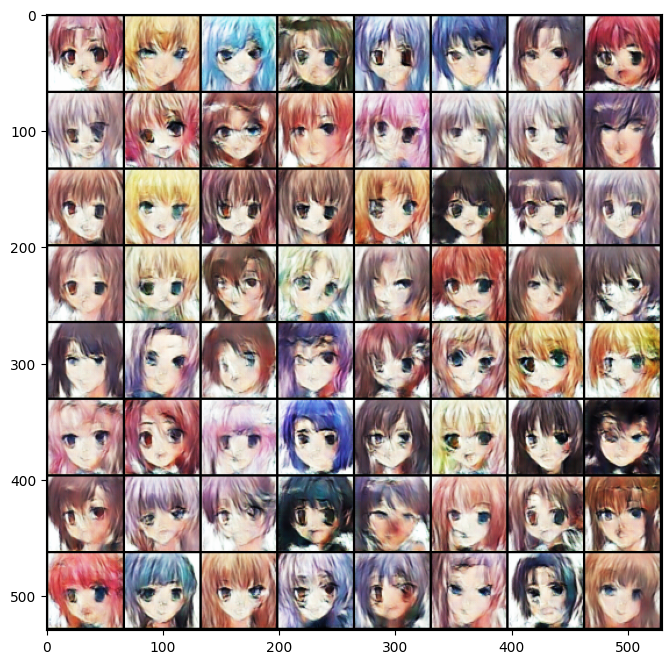

[10/15][0/497] Loss_D: 0.2788 Loss_G: 6.7747
[10/15][100/497] Loss_D: 0.2422 Loss_G: 4.6678
[10/15][200/497] Loss_D: 0.1084 Loss_G: 3.2342
[10/15][300/497] Loss_D: 3.9495 Loss_G: 14.3850
[10/15][400/497] Loss_D: 0.4155 Loss_G: 3.3517


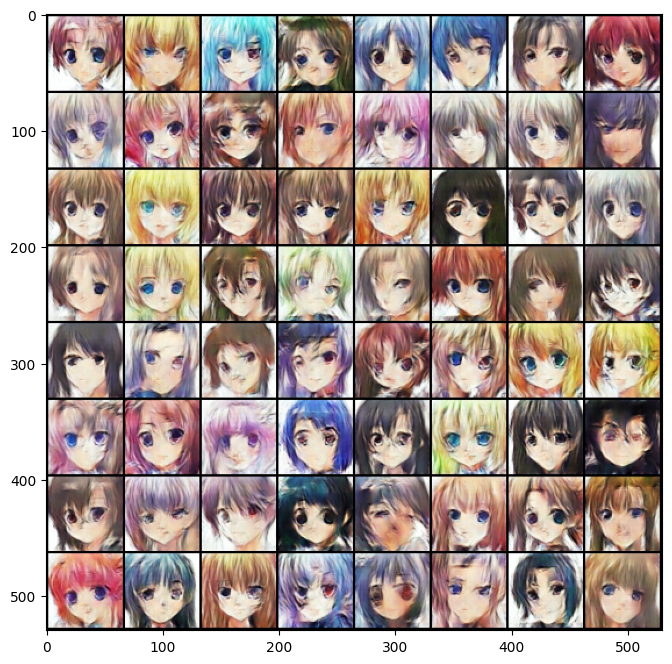

[11/15][0/497] Loss_D: 0.4615 Loss_G: 2.8295
[11/15][100/497] Loss_D: 0.2491 Loss_G: 3.9030
[11/15][200/497] Loss_D: 1.3320 Loss_G: 2.2537
[11/15][300/497] Loss_D: 0.4962 Loss_G: 2.2965
[11/15][400/497] Loss_D: 0.8036 Loss_G: 1.5187


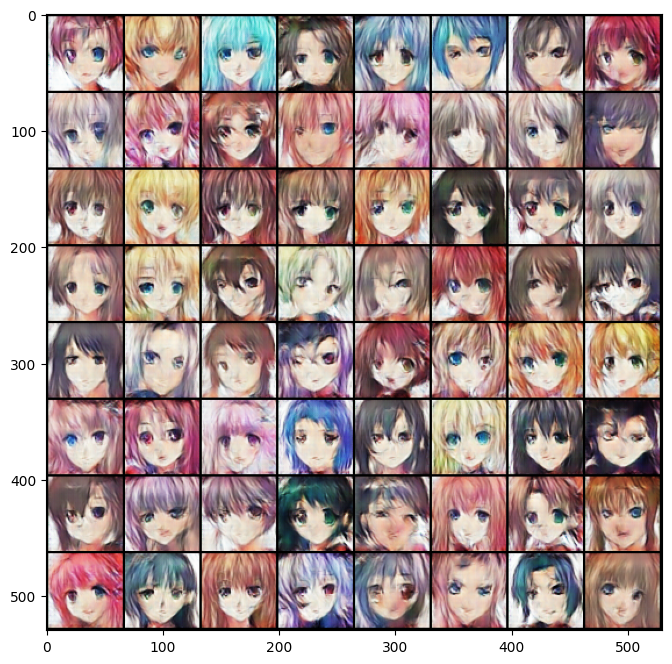

[12/15][0/497] Loss_D: 1.2140 Loss_G: 7.8055
[12/15][100/497] Loss_D: 0.2344 Loss_G: 3.6020
[12/15][200/497] Loss_D: 0.2343 Loss_G: 4.4498
[12/15][300/497] Loss_D: 0.1975 Loss_G: 2.9041
[12/15][400/497] Loss_D: 0.3785 Loss_G: 5.0112


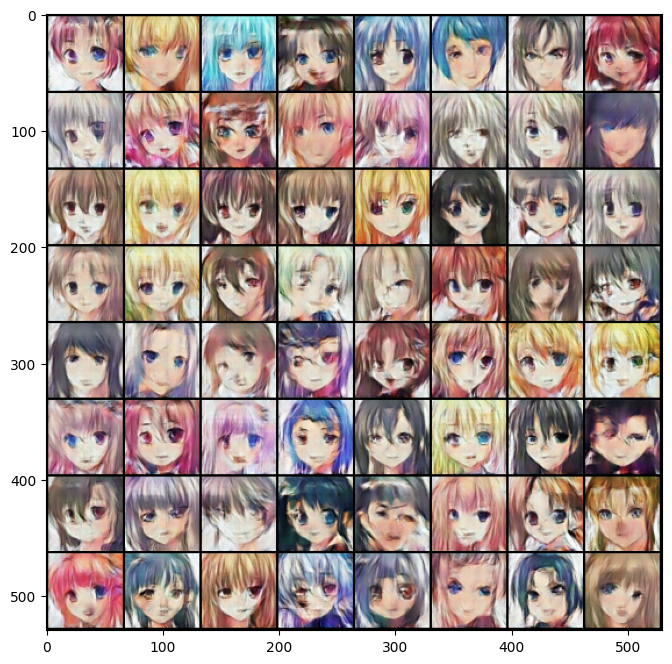

[13/15][0/497] Loss_D: 0.5763 Loss_G: 3.7799
[13/15][100/497] Loss_D: 0.3197 Loss_G: 5.5402
[13/15][200/497] Loss_D: 0.2138 Loss_G: 3.5249
[13/15][300/497] Loss_D: 0.4972 Loss_G: 3.0381
[13/15][400/497] Loss_D: 0.3349 Loss_G: 4.7794


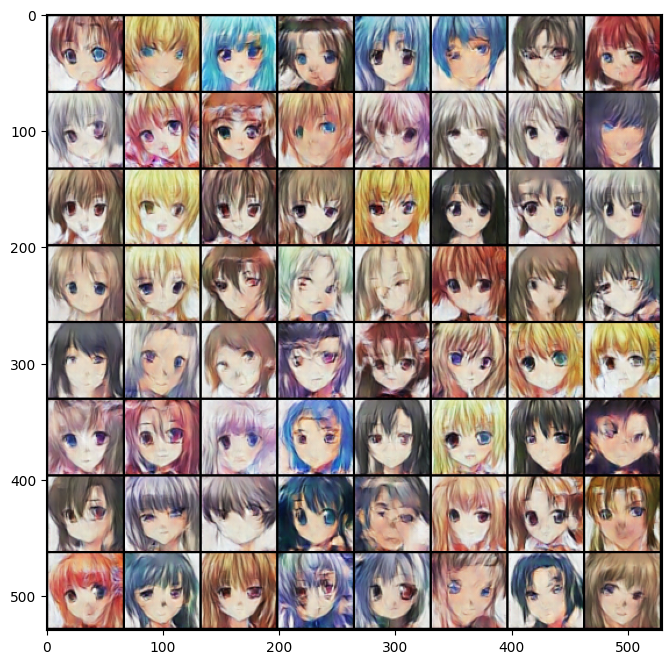

[14/15][0/497] Loss_D: 0.2454 Loss_G: 3.2514
[14/15][100/497] Loss_D: 0.5396 Loss_G: 2.7291
[14/15][200/497] Loss_D: 0.2094 Loss_G: 3.7917
[14/15][300/497] Loss_D: 1.7277 Loss_G: 2.2020
[14/15][400/497] Loss_D: 0.5772 Loss_G: 5.3422


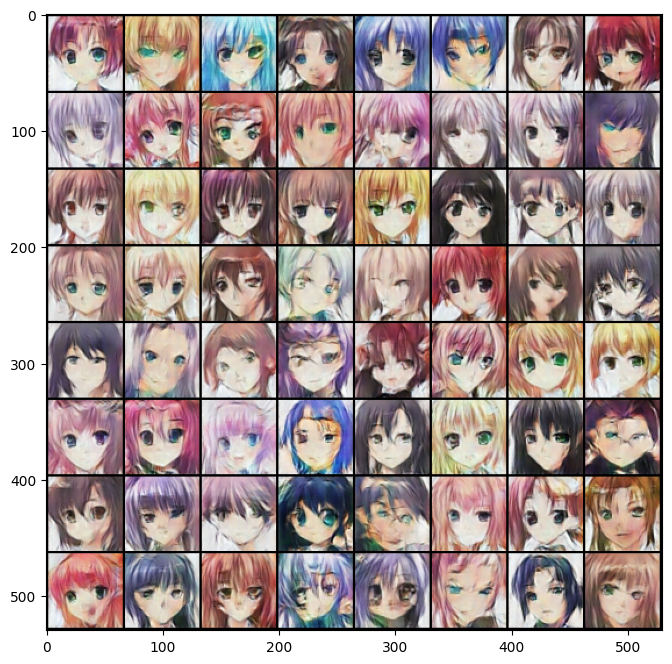

In [ ]:
for epoch in range(num_epochs):
    for i, data in enumerate(anime_loader, 0):
        netD.zero_grad()

        real_cpu = data.to(device)
        b_size = real_cpu.size(0)
        label = torch.full((b_size,), 1., dtype=torch.float, device=device)
        output = netD(real_cpu).view(-1)
        errD_real = criterion(output, label)
        errD_real.backward()

        noise = torch.randn(b_size, 100, 1, 1, device=device)
        fake = netG(noise)
        label.fill_(0.)
        output = netD(fake.detach()).view(-1)
        errD_fake = criterion(output, label)
        errD_fake.backward()

        optimizerD.step()

        netG.zero_grad()
        label.fill_(1.)
        output = netD(fake).view(-1)
        errG = criterion(output, label)
        errG.backward()
        optimizerG.step()

        if i % 100 == 0:
            print(f'[{epoch}/{num_epochs}][{i}/{len(anime_loader)}] Loss_D: {errD_real+errD_fake:.4f} Loss_G: {errG:.4f}')
    with torch.no_grad():
        fake = netG(fixed_noise).detach().cpu()
    plt.figure(figsize=(8,8))
    plt.imshow(np.transpose(vutils.make_grid(fake, padding=2, normalize=True),(1,2,0)))
    plt.show()

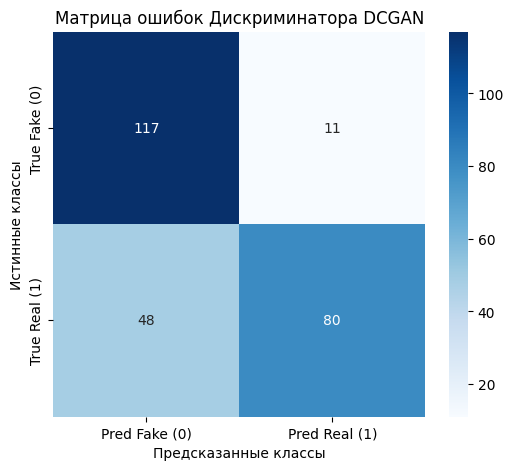

In [ ]:
from sklearn.metrics import confusion_matrix
import seaborn as sns
import matplotlib.pyplot as plt

def plot_gan_confusion_matrix(netD, netG, dataloader, device):
    netD.eval()
    netG.eval()

    y_true = []
    y_pred = []
    try:
        real_imgs, _ = next(iter(dataloader))
    except ValueError:
        real_imgs = next(iter(dataloader))
        if isinstance(real_imgs, list): real_imgs = real_imgs[0]

    real_imgs = real_imgs.to(device)
    batch_size = real_imgs.size(0)

    with torch.no_grad():
        output_real = netD(real_imgs).view(-1).cpu()
        preds_real = (output_real > 0.5).float().numpy()

        y_true.extend([1] * batch_size)
        y_pred.extend(preds_real)
    noise = torch.randn(batch_size, 100, 1, 1, device=device)
    with torch.no_grad():
        fake_imgs = netG(noise)
        output_fake = netD(fake_imgs).view(-1).cpu()
        preds_fake = (output_fake > 0.5).float().numpy()

        y_true.extend([0] * batch_size)
        y_pred.extend(preds_fake)

    cm = confusion_matrix(y_true, y_pred)

    plt.figure(figsize=(6, 5))
    sns.heatmap(cm, annot=True, fmt='d', cmap='Blues',
                xticklabels=['Pred Fake (0)', 'Pred Real (1)'],
                yticklabels=['True Fake (0)', 'True Real (1)'])
    plt.ylabel('Истинные классы')
    plt.xlabel('Предсказанные классы')
    plt.title('Матрица ошибок Дискриминатора DCGAN')
    plt.show()
    netD.train()
    netG.train()
plot_gan_confusion_matrix(netD, netG, anime_loader, device)

<p class="task" id="3"></p>

3\. Создайте наборы данных на основе архива `summer2winter_yosemite.zip`. Используя преобразования `torchvision`, приведите изображения к одному размеру и нормализуйте их. Выведите на экран несколько примеров изображений, расположив изображения из одной пары рядом по горизонтали.

- [ ] Проверено на семинаре

In [ ]:
class UnpairedDataset(Dataset):
    def __init__(self, root, mode='train', transform=None):
        self.transform = transform
        path_A = os.path.join(root, mode, 'A', '*')
        path_B = os.path.join(root, mode, 'B', '*')

        self.files_A = sorted(glob.glob(path_A))
        self.files_B = sorted(glob.glob(path_B))

        print(f"[{mode}] Загружено изображений: A={len(self.files_A)}, B={len(self.files_B)}")

    def __getitem__(self, index):
        file_A = self.files_A[index % len(self.files_A)]
        img_A = Image.open(file_A).convert('RGB')
        idx_B = random.randint(0, len(self.files_B) - 1)
        file_B = self.files_B[idx_B]
        img_B = Image.open(file_B).convert('RGB')
        if self.transform:
            img_A = self.transform(img_A)
            img_B = self.transform(img_B)

        return {'A': img_A, 'B': img_B}

    def __len__(self):
        return max(len(self.files_A), len(self.files_B))

In [ ]:
cycle_transforms = transforms.Compose([
    transforms.Resize(int(256 * 1.12), Image.BICUBIC),
    transforms.RandomCrop(256),
    transforms.RandomHorizontalFlip(),
    transforms.ToTensor(),
    transforms.Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5))
])

In [ ]:
test_transforms = transforms.Compose([
    transforms.Resize((256, 256)),
    transforms.ToTensor(),
    transforms.Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5))
])

In [ ]:
zip_path = "summer2winter_yosemite.zip"
extract_root = "summer2winter_yosemite"

In [ ]:
if not os.path.exists(extract_root):
    with zipfile.ZipFile(zip_path, "r") as zf:
        zf.extractall(extract_root)

In [ ]:
data_root = extract_root
if not (os.path.isdir(os.path.join(data_root, "train")) and os.path.isdir(os.path.join(data_root, "test"))):
    inner = os.path.join(extract_root, "summer2winter_yosemite")
    if os.path.isdir(inner):
        data_root = inner

In [ ]:
train_data = UnpairedDataset(data_root, mode='train', transform=cycle_transforms)
test_data = UnpairedDataset(data_root, mode='test', transform=test_transforms)
train_loader_cycle = DataLoader(train_data, batch_size=1, shuffle=True, num_workers=0)
test_loader_cycle = DataLoader(test_data, batch_size=5, shuffle=False, num_workers=0)

[train] Загружено изображений: A=1231, B=962
[test] Загружено изображений: A=309, B=238


In [ ]:
batch = next(iter(train_loader_cycle))

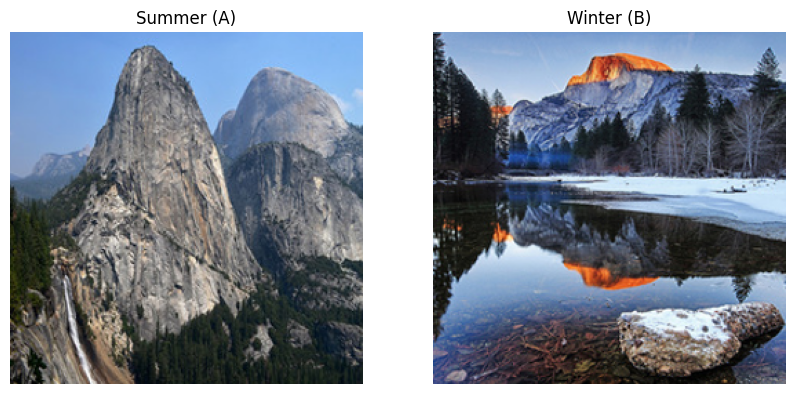

In [ ]:
plt.figure(figsize=(10, 5))
plt.subplot(1, 2, 1)
plt.title("Summer (A)")
plt.axis("off")
plt.imshow(np.transpose(vutils.make_grid(batch['A'], normalize=True).cpu(), (1, 2, 0)))
plt.subplot(1, 2, 2)
plt.title("Winter (B)")
plt.axis("off")
plt.imshow(np.transpose(vutils.make_grid(batch['B'], normalize=True).cpu(), (1, 2, 0)))
plt.show()

<p class="task" id="4"></p>

4\. Реализуйте архитектуру `CycleGAN` и обучите модель. Подберите гиперпараметры таким образом, чтобы получаемые изображения стали достаточного качественными (четкими и без существенных дефектов). Во время обучения сохраняйте примеры преобразования (в обе стороны) и  сравните, как менялось качество получаемых изображений в процессе обучения.

- [ ] Проверено на семинаре

In [ ]:
import torch
import torch.nn as nn
import torch.optim as optim
import torchvision.utils as vutils
import numpy as np
import matplotlib.pyplot as plt

In [ ]:
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
def weights_init(m):
    classname = m.__class__.__name__
    if classname.find('Conv') != -1:
        nn.init.normal_(m.weight.data, 0.0, 0.02)
        if hasattr(m, 'bias') and m.bias is not None:
            nn.init.constant_(m.bias.data, 0)

    elif classname.find('InstanceNorm') != -1:
        if m.weight is not None and m.bias is not None:
            nn.init.normal_(m.weight.data, 1.0, 0.02)
            nn.init.constant_(m.bias.data, 0)

    elif classname.find('BatchNorm') != -1:
        nn.init.normal_(m.weight.data, 1.0, 0.02)
        nn.init.constant_(m.bias.data, 0)

In [ ]:
class ResidualBlock(nn.Module):
    def __init__(self, in_features):
        super(ResidualBlock, self).__init__()
        self.block = nn.Sequential(
            nn.ReflectionPad2d(1),
            nn.Conv2d(in_features, in_features, 3),
            nn.InstanceNorm2d(in_features),
            nn.ReLU(inplace=True),
            nn.ReflectionPad2d(1),
            nn.Conv2d(in_features, in_features, 3),
            nn.InstanceNorm2d(in_features)
        )

    def forward(self, x):
        return x + self.block(x)

In [ ]:
class CycleGenerator(nn.Module):
    def __init__(self, input_shape=(3, 256, 256), num_residual_blocks=9):
        super(CycleGenerator, self).__init__()
        channels = input_shape[0]
        model = [
            nn.ReflectionPad2d(3),
            nn.Conv2d(channels, 64, 7),
            nn.InstanceNorm2d(64),
            nn.ReLU(inplace=True)
        ]

        in_features = 64
        out_features = in_features * 2
        for _ in range(2):
            model += [
                nn.Conv2d(in_features, out_features, 3, stride=2, padding=1),
                nn.InstanceNorm2d(out_features),
                nn.ReLU(inplace=True)
            ]
            in_features = out_features
            out_features = in_features * 2

        for _ in range(num_residual_blocks):
            model += [ResidualBlock(in_features)]

        out_features = in_features // 2
        for _ in range(2):
            model += [
                nn.ConvTranspose2d(in_features, out_features, 3, stride=2, padding=1, output_padding=1),
                nn.InstanceNorm2d(out_features),
                nn.ReLU(inplace=True)
            ]
            in_features = out_features
            out_features = in_features // 2

        model += [
            nn.ReflectionPad2d(3),
            nn.Conv2d(64, channels, 7),
            nn.Tanh()
        ]

        self.model = nn.Sequential(*model)

    def forward(self, x):
        return self.model(x)

In [ ]:
class CycleDiscriminator(nn.Module):
    def __init__(self, input_shape=(3, 256, 256)):
        super(CycleDiscriminator, self).__init__()
        channels, height, width = input_shape

        def discriminator_block(in_filters, out_filters, normalize=True):
            layers = [nn.Conv2d(in_filters, out_filters, 4, stride=2, padding=1)]
            if normalize:
                layers.append(nn.InstanceNorm2d(out_filters))
            layers.append(nn.LeakyReLU(0.2, inplace=True))
            return layers

        self.model = nn.Sequential(
            *discriminator_block(channels, 64, normalize=False),
            *discriminator_block(64, 128),
            *discriminator_block(128, 256),
            *discriminator_block(256, 512),
            nn.ZeroPad2d((1, 0, 1, 0)),
            nn.Conv2d(512, 1, 4, padding=1)
        )

    def forward(self, img):
        return self.model(img)

In [ ]:
G_AB = CycleGenerator().to(device)
G_BA = CycleGenerator().to(device)
D_A = CycleDiscriminator().to(device)
D_B = CycleDiscriminator().to(device)

In [ ]:
G_AB.apply(weights_init)
G_BA.apply(weights_init)
D_A.apply(weights_init)
D_B.apply(weights_init)

CycleDiscriminator(
  (model): Sequential(
    (0): Conv2d(3, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1))
    (1): LeakyReLU(negative_slope=0.2, inplace=True)
    (2): Conv2d(64, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1))
    (3): InstanceNorm2d(128, eps=1e-05, momentum=0.1, affine=False, track_running_stats=False)
    (4): LeakyReLU(negative_slope=0.2, inplace=True)
    (5): Conv2d(128, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1))
    (6): InstanceNorm2d(256, eps=1e-05, momentum=0.1, affine=False, track_running_stats=False)
    (7): LeakyReLU(negative_slope=0.2, inplace=True)
    (8): Conv2d(256, 512, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1))
    (9): InstanceNorm2d(512, eps=1e-05, momentum=0.1, affine=False, track_running_stats=False)
    (10): LeakyReLU(negative_slope=0.2, inplace=True)
    (11): ZeroPad2d((1, 0, 1, 0))
    (12): Conv2d(512, 1, kernel_size=(4, 4), stride=(1, 1), padding=(1, 1))
  )
)

In [ ]:
criterion_GAN = nn.MSELoss()
criterion_cycle = nn.L1Loss()
criterion_identity = nn.L1Loss()

In [ ]:
optimizer_G = optim.Adam(list(G_AB.parameters()) + list(G_BA.parameters()), lr=0.0002, betas=(0.5, 0.999))
optimizer_D_A = optim.Adam(D_A.parameters(), lr=0.0002, betas=(0.5, 0.999))
optimizer_D_B = optim.Adam(D_B.parameters(), lr=0.0002, betas=(0.5, 0.999))

In [ ]:
n_epochs = 10
print_every = 50

[Epoch 0/10] [Batch 0/1231] [G loss: 21.2451]
[Epoch 0/10] [Batch 50/1231] [G loss: 8.9316]
[Epoch 0/10] [Batch 100/1231] [G loss: 10.8597]
[Epoch 0/10] [Batch 150/1231] [G loss: 11.5491]
[Epoch 0/10] [Batch 200/1231] [G loss: 6.7760]
[Epoch 0/10] [Batch 250/1231] [G loss: 6.3643]
[Epoch 0/10] [Batch 300/1231] [G loss: 7.6105]
[Epoch 0/10] [Batch 350/1231] [G loss: 6.1582]
[Epoch 0/10] [Batch 400/1231] [G loss: 7.0431]
[Epoch 0/10] [Batch 450/1231] [G loss: 8.9802]
[Epoch 0/10] [Batch 500/1231] [G loss: 6.8089]
[Epoch 0/10] [Batch 550/1231] [G loss: 6.9390]
[Epoch 0/10] [Batch 600/1231] [G loss: 7.8394]
[Epoch 0/10] [Batch 650/1231] [G loss: 7.7608]
[Epoch 0/10] [Batch 700/1231] [G loss: 6.3527]
[Epoch 0/10] [Batch 750/1231] [G loss: 8.1928]
[Epoch 0/10] [Batch 800/1231] [G loss: 6.5802]
[Epoch 0/10] [Batch 850/1231] [G loss: 6.3095]
[Epoch 0/10] [Batch 900/1231] [G loss: 8.3476]
[Epoch 0/10] [Batch 950/1231] [G loss: 8.7409]
[Epoch 0/10] [Batch 1000/1231] [G loss: 5.2700]
[Epoch 0/10]

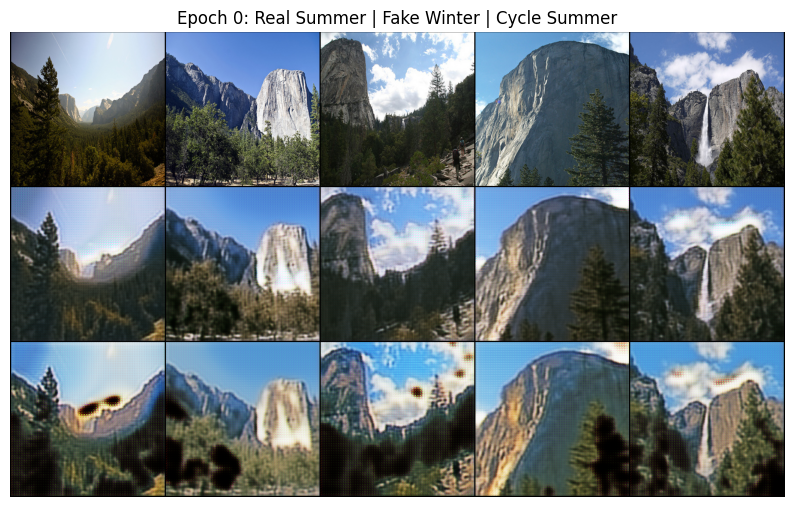

[Epoch 1/10] [Batch 0/1231] [G loss: 9.3976]
[Epoch 1/10] [Batch 50/1231] [G loss: 7.0897]
[Epoch 1/10] [Batch 100/1231] [G loss: 6.4497]
[Epoch 1/10] [Batch 150/1231] [G loss: 8.3218]
[Epoch 1/10] [Batch 200/1231] [G loss: 6.0009]
[Epoch 1/10] [Batch 250/1231] [G loss: 8.5749]
[Epoch 1/10] [Batch 300/1231] [G loss: 7.0666]
[Epoch 1/10] [Batch 350/1231] [G loss: 7.1023]
[Epoch 1/10] [Batch 400/1231] [G loss: 5.8209]
[Epoch 1/10] [Batch 450/1231] [G loss: 7.9838]
[Epoch 1/10] [Batch 500/1231] [G loss: 5.9203]
[Epoch 1/10] [Batch 550/1231] [G loss: 5.0176]
[Epoch 1/10] [Batch 600/1231] [G loss: 5.9604]
[Epoch 1/10] [Batch 650/1231] [G loss: 4.2848]
[Epoch 1/10] [Batch 700/1231] [G loss: 6.8135]
[Epoch 1/10] [Batch 750/1231] [G loss: 5.3239]
[Epoch 1/10] [Batch 800/1231] [G loss: 8.2417]
[Epoch 1/10] [Batch 850/1231] [G loss: 6.9933]
[Epoch 1/10] [Batch 900/1231] [G loss: 6.3924]
[Epoch 1/10] [Batch 950/1231] [G loss: 4.9973]
[Epoch 1/10] [Batch 1000/1231] [G loss: 6.5397]
[Epoch 1/10] [B

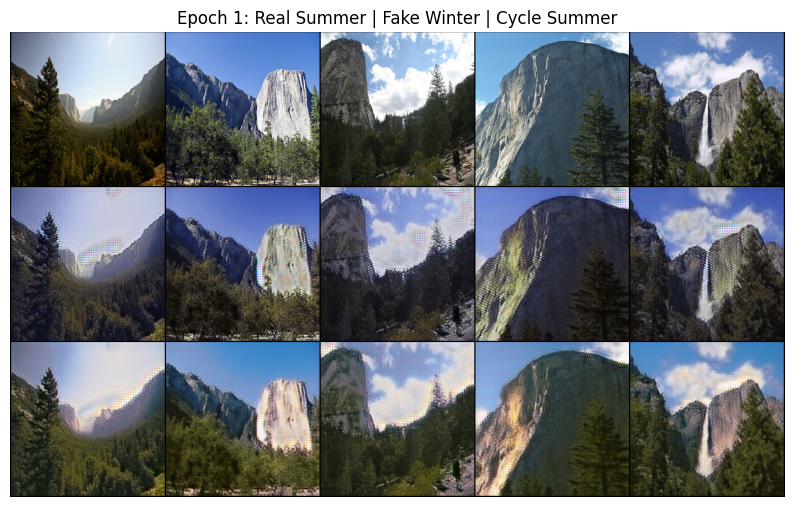

[Epoch 2/10] [Batch 0/1231] [G loss: 5.5245]
[Epoch 2/10] [Batch 50/1231] [G loss: 5.9032]
[Epoch 2/10] [Batch 100/1231] [G loss: 5.1057]
[Epoch 2/10] [Batch 150/1231] [G loss: 8.2050]
[Epoch 2/10] [Batch 200/1231] [G loss: 5.4063]
[Epoch 2/10] [Batch 250/1231] [G loss: 6.1793]
[Epoch 2/10] [Batch 300/1231] [G loss: 6.0044]
[Epoch 2/10] [Batch 350/1231] [G loss: 6.9509]
[Epoch 2/10] [Batch 400/1231] [G loss: 4.1200]
[Epoch 2/10] [Batch 450/1231] [G loss: 6.2550]
[Epoch 2/10] [Batch 500/1231] [G loss: 8.0596]
[Epoch 2/10] [Batch 550/1231] [G loss: 6.0406]
[Epoch 2/10] [Batch 600/1231] [G loss: 5.5894]
[Epoch 2/10] [Batch 650/1231] [G loss: 5.1362]
[Epoch 2/10] [Batch 700/1231] [G loss: 4.8953]
[Epoch 2/10] [Batch 750/1231] [G loss: 6.4186]
[Epoch 2/10] [Batch 800/1231] [G loss: 6.2804]
[Epoch 2/10] [Batch 850/1231] [G loss: 4.8553]
[Epoch 2/10] [Batch 900/1231] [G loss: 6.3542]
[Epoch 2/10] [Batch 950/1231] [G loss: 7.4898]
[Epoch 2/10] [Batch 1000/1231] [G loss: 8.2530]
[Epoch 2/10] [B

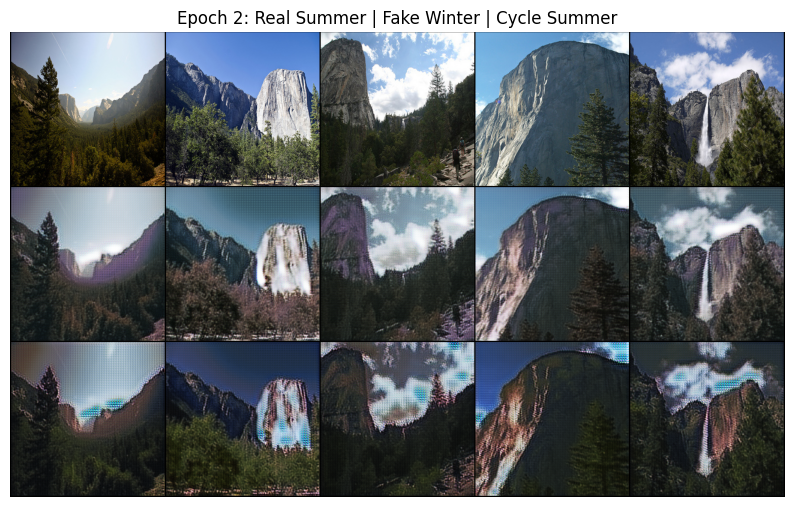

[Epoch 3/10] [Batch 0/1231] [G loss: 8.1486]
[Epoch 3/10] [Batch 50/1231] [G loss: 6.0762]
[Epoch 3/10] [Batch 100/1231] [G loss: 4.6178]
[Epoch 3/10] [Batch 150/1231] [G loss: 4.3725]
[Epoch 3/10] [Batch 200/1231] [G loss: 6.1150]
[Epoch 3/10] [Batch 250/1231] [G loss: 5.3658]
[Epoch 3/10] [Batch 300/1231] [G loss: 5.1328]
[Epoch 3/10] [Batch 350/1231] [G loss: 8.5983]
[Epoch 3/10] [Batch 400/1231] [G loss: 5.7800]
[Epoch 3/10] [Batch 450/1231] [G loss: 4.7387]
[Epoch 3/10] [Batch 500/1231] [G loss: 5.2564]
[Epoch 3/10] [Batch 550/1231] [G loss: 5.0828]
[Epoch 3/10] [Batch 600/1231] [G loss: 4.6286]
[Epoch 3/10] [Batch 650/1231] [G loss: 8.1114]
[Epoch 3/10] [Batch 700/1231] [G loss: 5.5010]
[Epoch 3/10] [Batch 750/1231] [G loss: 4.4637]
[Epoch 3/10] [Batch 800/1231] [G loss: 7.9295]
[Epoch 3/10] [Batch 850/1231] [G loss: 4.8482]
[Epoch 3/10] [Batch 900/1231] [G loss: 4.6693]
[Epoch 3/10] [Batch 950/1231] [G loss: 4.5253]
[Epoch 3/10] [Batch 1000/1231] [G loss: 4.7875]
[Epoch 3/10] [B

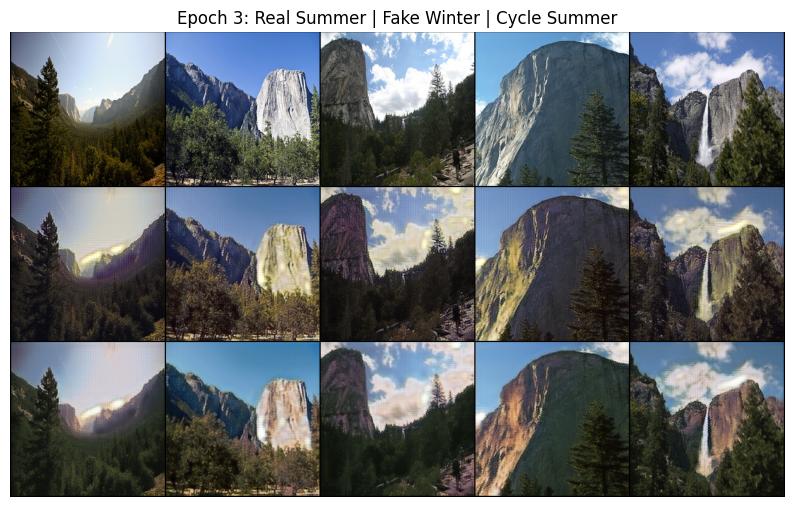

[Epoch 4/10] [Batch 0/1231] [G loss: 4.2298]
[Epoch 4/10] [Batch 50/1231] [G loss: 4.7674]
[Epoch 4/10] [Batch 100/1231] [G loss: 5.0733]
[Epoch 4/10] [Batch 150/1231] [G loss: 4.6168]
[Epoch 4/10] [Batch 200/1231] [G loss: 5.5833]
[Epoch 4/10] [Batch 250/1231] [G loss: 4.6925]
[Epoch 4/10] [Batch 300/1231] [G loss: 6.1573]
[Epoch 4/10] [Batch 350/1231] [G loss: 6.2520]
[Epoch 4/10] [Batch 400/1231] [G loss: 5.4456]
[Epoch 4/10] [Batch 450/1231] [G loss: 6.5061]
[Epoch 4/10] [Batch 500/1231] [G loss: 5.0901]
[Epoch 4/10] [Batch 550/1231] [G loss: 8.6849]
[Epoch 4/10] [Batch 600/1231] [G loss: 3.9594]
[Epoch 4/10] [Batch 650/1231] [G loss: 4.3699]
[Epoch 4/10] [Batch 700/1231] [G loss: 5.2467]
[Epoch 4/10] [Batch 750/1231] [G loss: 4.5701]
[Epoch 4/10] [Batch 800/1231] [G loss: 3.5995]
[Epoch 4/10] [Batch 850/1231] [G loss: 7.4008]
[Epoch 4/10] [Batch 900/1231] [G loss: 7.7139]
[Epoch 4/10] [Batch 950/1231] [G loss: 4.2866]
[Epoch 4/10] [Batch 1000/1231] [G loss: 5.4307]
[Epoch 4/10] [B

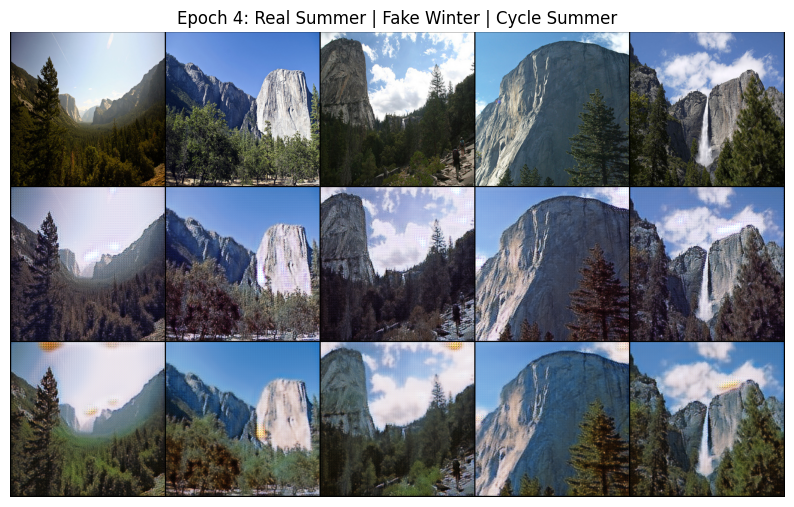

[Epoch 5/10] [Batch 0/1231] [G loss: 6.1691]
[Epoch 5/10] [Batch 50/1231] [G loss: 4.4160]
[Epoch 5/10] [Batch 100/1231] [G loss: 4.4273]
[Epoch 5/10] [Batch 150/1231] [G loss: 4.4272]
[Epoch 5/10] [Batch 200/1231] [G loss: 6.4783]
[Epoch 5/10] [Batch 250/1231] [G loss: 3.9937]
[Epoch 5/10] [Batch 300/1231] [G loss: 4.0449]
[Epoch 5/10] [Batch 350/1231] [G loss: 5.7947]
[Epoch 5/10] [Batch 400/1231] [G loss: 4.1865]
[Epoch 5/10] [Batch 450/1231] [G loss: 5.7246]
[Epoch 5/10] [Batch 500/1231] [G loss: 4.8159]
[Epoch 5/10] [Batch 550/1231] [G loss: 3.6322]
[Epoch 5/10] [Batch 600/1231] [G loss: 4.5875]
[Epoch 5/10] [Batch 650/1231] [G loss: 6.2825]
[Epoch 5/10] [Batch 700/1231] [G loss: 5.3797]
[Epoch 5/10] [Batch 750/1231] [G loss: 3.9355]
[Epoch 5/10] [Batch 800/1231] [G loss: 6.7543]
[Epoch 5/10] [Batch 850/1231] [G loss: 6.4470]
[Epoch 5/10] [Batch 900/1231] [G loss: 3.9230]
[Epoch 5/10] [Batch 950/1231] [G loss: 6.0129]
[Epoch 5/10] [Batch 1000/1231] [G loss: 5.2875]
[Epoch 5/10] [B

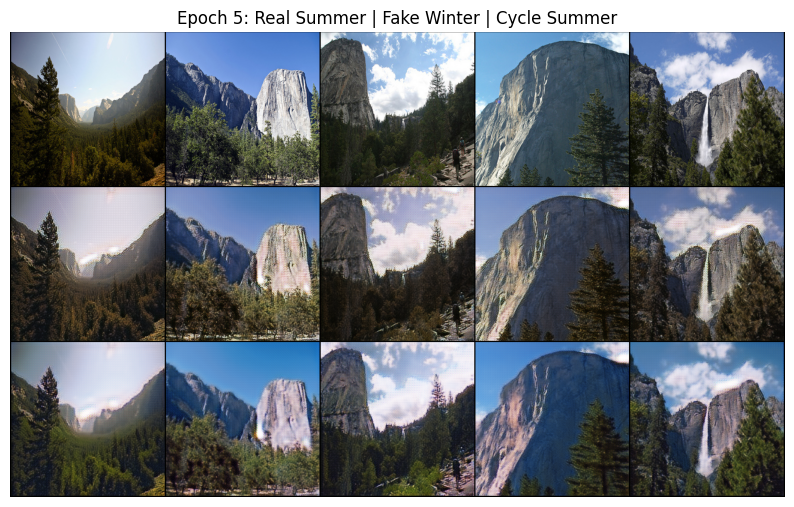

[Epoch 6/10] [Batch 0/1231] [G loss: 4.3228]
[Epoch 6/10] [Batch 50/1231] [G loss: 4.7442]
[Epoch 6/10] [Batch 100/1231] [G loss: 10.0659]
[Epoch 6/10] [Batch 150/1231] [G loss: 4.0070]
[Epoch 6/10] [Batch 200/1231] [G loss: 5.5237]
[Epoch 6/10] [Batch 250/1231] [G loss: 7.8680]
[Epoch 6/10] [Batch 300/1231] [G loss: 4.2492]
[Epoch 6/10] [Batch 350/1231] [G loss: 6.6263]
[Epoch 6/10] [Batch 400/1231] [G loss: 3.7297]
[Epoch 6/10] [Batch 450/1231] [G loss: 7.2723]
[Epoch 6/10] [Batch 500/1231] [G loss: 6.0070]
[Epoch 6/10] [Batch 550/1231] [G loss: 5.5728]
[Epoch 6/10] [Batch 600/1231] [G loss: 5.9467]
[Epoch 6/10] [Batch 650/1231] [G loss: 6.3214]
[Epoch 6/10] [Batch 700/1231] [G loss: 4.8683]
[Epoch 6/10] [Batch 750/1231] [G loss: 6.0916]
[Epoch 6/10] [Batch 800/1231] [G loss: 3.9094]
[Epoch 6/10] [Batch 850/1231] [G loss: 7.4438]
[Epoch 6/10] [Batch 900/1231] [G loss: 3.9466]
[Epoch 6/10] [Batch 950/1231] [G loss: 3.9572]
[Epoch 6/10] [Batch 1000/1231] [G loss: 5.1890]
[Epoch 6/10] [

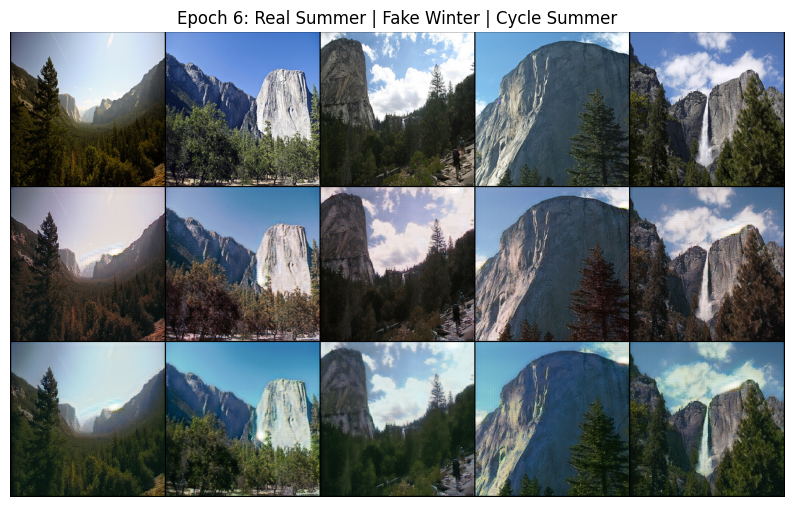

[Epoch 7/10] [Batch 0/1231] [G loss: 4.0336]
[Epoch 7/10] [Batch 50/1231] [G loss: 3.5419]
[Epoch 7/10] [Batch 100/1231] [G loss: 3.8074]
[Epoch 7/10] [Batch 150/1231] [G loss: 4.9483]
[Epoch 7/10] [Batch 200/1231] [G loss: 5.0836]
[Epoch 7/10] [Batch 250/1231] [G loss: 3.3954]
[Epoch 7/10] [Batch 300/1231] [G loss: 4.8638]
[Epoch 7/10] [Batch 350/1231] [G loss: 4.5869]
[Epoch 7/10] [Batch 400/1231] [G loss: 4.7995]
[Epoch 7/10] [Batch 450/1231] [G loss: 3.3168]
[Epoch 7/10] [Batch 500/1231] [G loss: 3.5270]
[Epoch 7/10] [Batch 550/1231] [G loss: 4.7943]
[Epoch 7/10] [Batch 600/1231] [G loss: 3.5137]
[Epoch 7/10] [Batch 650/1231] [G loss: 4.9839]
[Epoch 7/10] [Batch 700/1231] [G loss: 3.9212]
[Epoch 7/10] [Batch 750/1231] [G loss: 5.5629]
[Epoch 7/10] [Batch 800/1231] [G loss: 3.6610]
[Epoch 7/10] [Batch 850/1231] [G loss: 3.9914]
[Epoch 7/10] [Batch 900/1231] [G loss: 4.7062]
[Epoch 7/10] [Batch 950/1231] [G loss: 6.1056]
[Epoch 7/10] [Batch 1000/1231] [G loss: 4.6010]
[Epoch 7/10] [B

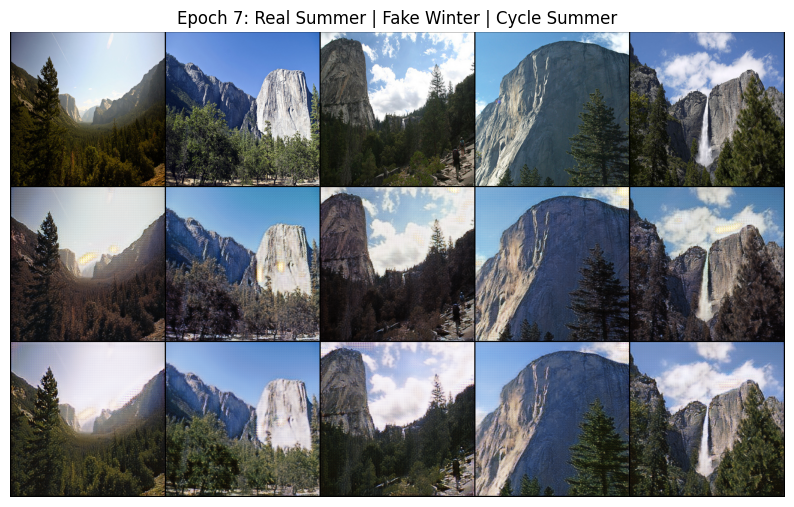

[Epoch 8/10] [Batch 0/1231] [G loss: 3.9558]
[Epoch 8/10] [Batch 50/1231] [G loss: 6.6016]
[Epoch 8/10] [Batch 100/1231] [G loss: 3.9509]
[Epoch 8/10] [Batch 150/1231] [G loss: 3.9551]
[Epoch 8/10] [Batch 200/1231] [G loss: 3.9685]
[Epoch 8/10] [Batch 250/1231] [G loss: 4.4706]
[Epoch 8/10] [Batch 300/1231] [G loss: 4.2855]
[Epoch 8/10] [Batch 350/1231] [G loss: 5.5334]
[Epoch 8/10] [Batch 400/1231] [G loss: 4.4623]
[Epoch 8/10] [Batch 450/1231] [G loss: 4.4631]
[Epoch 8/10] [Batch 500/1231] [G loss: 4.2263]
[Epoch 8/10] [Batch 550/1231] [G loss: 5.0613]
[Epoch 8/10] [Batch 600/1231] [G loss: 6.9753]
[Epoch 8/10] [Batch 650/1231] [G loss: 5.6000]
[Epoch 8/10] [Batch 700/1231] [G loss: 5.6026]
[Epoch 8/10] [Batch 750/1231] [G loss: 4.9625]
[Epoch 8/10] [Batch 800/1231] [G loss: 3.9641]
[Epoch 8/10] [Batch 850/1231] [G loss: 4.0870]
[Epoch 8/10] [Batch 900/1231] [G loss: 5.2256]
[Epoch 8/10] [Batch 950/1231] [G loss: 6.9562]
[Epoch 8/10] [Batch 1000/1231] [G loss: 3.4977]
[Epoch 8/10] [B

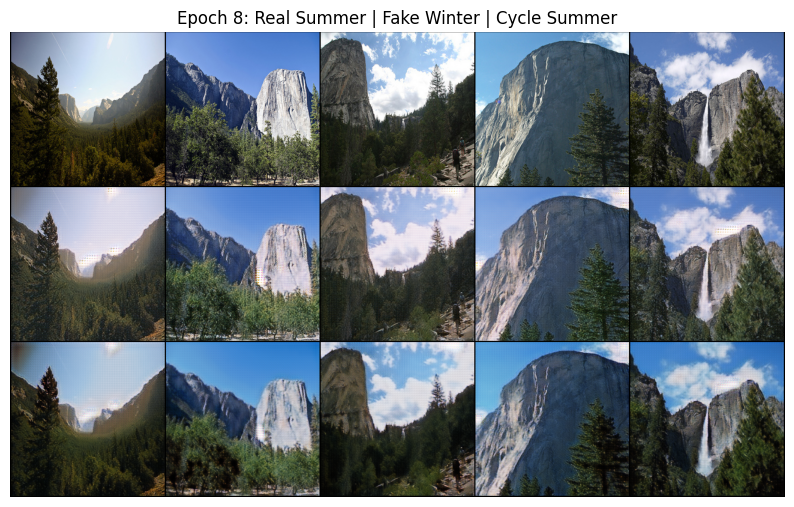

[Epoch 9/10] [Batch 0/1231] [G loss: 3.5338]
[Epoch 9/10] [Batch 50/1231] [G loss: 2.9541]
[Epoch 9/10] [Batch 100/1231] [G loss: 5.0213]
[Epoch 9/10] [Batch 150/1231] [G loss: 4.0622]
[Epoch 9/10] [Batch 200/1231] [G loss: 3.6502]
[Epoch 9/10] [Batch 250/1231] [G loss: 6.0353]
[Epoch 9/10] [Batch 300/1231] [G loss: 4.0846]
[Epoch 9/10] [Batch 350/1231] [G loss: 3.6019]
[Epoch 9/10] [Batch 400/1231] [G loss: 3.9163]
[Epoch 9/10] [Batch 450/1231] [G loss: 6.3202]
[Epoch 9/10] [Batch 500/1231] [G loss: 3.6554]
[Epoch 9/10] [Batch 550/1231] [G loss: 3.1113]
[Epoch 9/10] [Batch 600/1231] [G loss: 3.9771]
[Epoch 9/10] [Batch 650/1231] [G loss: 5.0752]
[Epoch 9/10] [Batch 700/1231] [G loss: 5.6357]
[Epoch 9/10] [Batch 750/1231] [G loss: 4.3949]
[Epoch 9/10] [Batch 800/1231] [G loss: 3.3491]
[Epoch 9/10] [Batch 850/1231] [G loss: 9.5950]
[Epoch 9/10] [Batch 900/1231] [G loss: 4.2609]
[Epoch 9/10] [Batch 950/1231] [G loss: 7.8352]
[Epoch 9/10] [Batch 1000/1231] [G loss: 3.6110]
[Epoch 9/10] [B

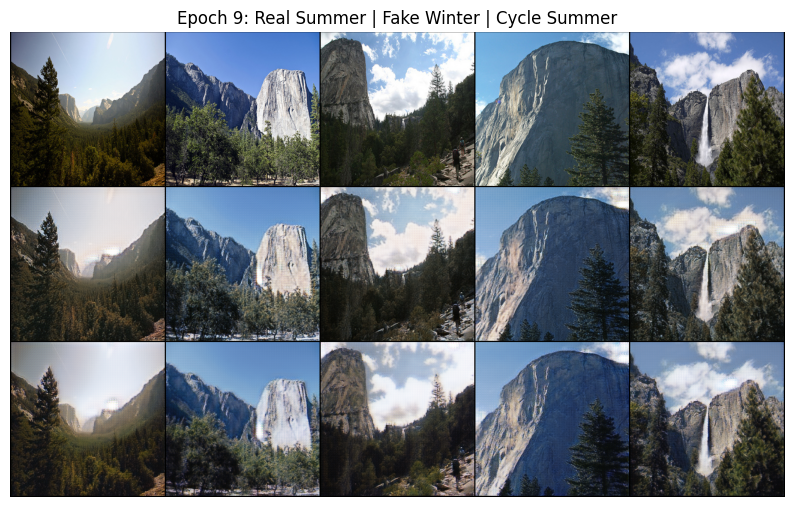

In [ ]:
for epoch in range(n_epochs):
    for i, batch in enumerate(train_loader_cycle):

        real_A = batch['A'].to(device)
        real_B = batch['B'].to(device)

        valid = torch.ones_like(D_A(real_A), requires_grad=False).to(device)
        fake = torch.zeros_like(D_A(real_A), requires_grad=False).to(device)

        G_AB.train()
        G_BA.train()
        optimizer_G.zero_grad()
        fake_B = G_AB(real_A)
        loss_GAN_AB = criterion_GAN(D_B(fake_B), valid)

        fake_A = G_BA(real_B)
        loss_GAN_BA = criterion_GAN(D_A(fake_A), valid)

        loss_GAN = (loss_GAN_AB + loss_GAN_BA) / 2

        recov_A = G_BA(fake_B)
        loss_cycle_A = criterion_cycle(recov_A, real_A) * 10.0

        recov_B = G_AB(fake_A)
        loss_cycle_B = criterion_cycle(recov_B, real_B) * 10.0

        loss_cycle = loss_cycle_A + loss_cycle_B

        loss_id_A = criterion_identity(G_BA(real_A), real_A) * 5.0
        loss_id_B = criterion_identity(G_AB(real_B), real_B) * 5.0
        loss_identity = loss_id_A + loss_id_B

        loss_G = loss_GAN + loss_cycle + loss_identity
        loss_G.backward()
        optimizer_G.step()

        optimizer_D_A.zero_grad()
        loss_real = criterion_GAN(D_A(real_A), valid)
        loss_fake = criterion_GAN(D_A(fake_A.detach()), fake)
        loss_D_A = (loss_real + loss_fake) / 2
        loss_D_A.backward()
        optimizer_D_A.step()

        optimizer_D_B.zero_grad()
        loss_real = criterion_GAN(D_B(real_B), valid)
        loss_fake = criterion_GAN(D_B(fake_B.detach()), fake)
        loss_D_B = (loss_real + loss_fake) / 2
        loss_D_B.backward()
        optimizer_D_B.step()

        if i % print_every == 0:
            print(f"[Epoch {epoch}/{n_epochs}] [Batch {i}/{len(train_loader_cycle)}] [G loss: {loss_G.item():.4f}]")

    with torch.no_grad():
        G_AB.eval()
        G_BA.eval()

        test_batch = next(iter(test_loader_cycle))
        real_A = test_batch['A'].to(device)
        fake_B = G_AB(real_A)
        recov_A = G_BA(fake_B)

        img_sample = torch.cat((real_A, fake_B, recov_A), 0)

        plt.figure(figsize=(10, 8))
        plt.axis("off")
        plt.title(f"Epoch {epoch}: Real Summer | Fake Winter | Cycle Summer")
        plt.imshow(np.transpose(vutils.make_grid(img_sample, nrow=5, padding=2, normalize=True).cpu(), (1,2,0)))
        plt.show()

In [ ]:
class UnpairedDataset(Dataset):
    def __init__(self, root, mode='train', transform=None):
        self.transform = transform
        path_A = os.path.join(root, mode, 'A', '*')
        path_B = os.path.join(root, mode, 'B', '*')

        self.files_A = sorted(glob.glob(path_A))
        self.files_B = sorted(glob.glob(path_B))

        print(f"[{mode}] Загружено изображений: A={len(self.files_A)}, B={len(self.files_B)}")

    def __getitem__(self, index):
        file_A = self.files_A[index % len(self.files_A)]
        img_A = Image.open(file_A).convert('RGB')
        idx_B = random.randint(0, len(self.files_B) - 1)
        file_B = self.files_B[idx_B]
        img_B = Image.open(file_B).convert('RGB')
        if self.transform:
            img_A = self.transform(img_A)
            img_B = self.transform(img_B)

        return {'A': img_A, 'B': img_B}

    def __len__(self):
        return max(len(self.files_A), len(self.files_B))

In [ ]:
cycle_transforms = transforms.Compose([
    transforms.Resize(int(256 * 1.12), Image.BICUBIC),
    transforms.RandomCrop(256),
    transforms.RandomHorizontalFlip(),
    transforms.ToTensor(),
    transforms.Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5))
])

In [ ]:
test_transforms = transforms.Compose([
    transforms.Resize((256, 256)),
    transforms.ToTensor(),
    transforms.Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5))
])

In [ ]:
zip_path = "summer2winter_yosemite.zip"
extract_root = "summer2winter_yosemite"

In [ ]:
if not os.path.exists(extract_root):
    with zipfile.ZipFile(zip_path, "r") as zf:
        zf.extractall(extract_root)

In [ ]:
data_root = extract_root
if not (os.path.isdir(os.path.join(data_root, "train")) and os.path.isdir(os.path.join(data_root, "test"))):
    inner = os.path.join(extract_root, "summer2winter_yosemite")
    if os.path.isdir(inner):
        data_root = inner

In [ ]:
train_data = UnpairedDataset(data_root, mode='train', transform=cycle_transforms)
test_data = UnpairedDataset(data_root, mode='test', transform=test_transforms)
train_loader_cycle = DataLoader(train_data, batch_size=1, shuffle=True, num_workers=0)
test_loader_cycle = DataLoader(test_data, batch_size=5, shuffle=False, num_workers=0)

[train] Загружено изображений: A=1231, B=962
[test] Загружено изображений: A=309, B=238


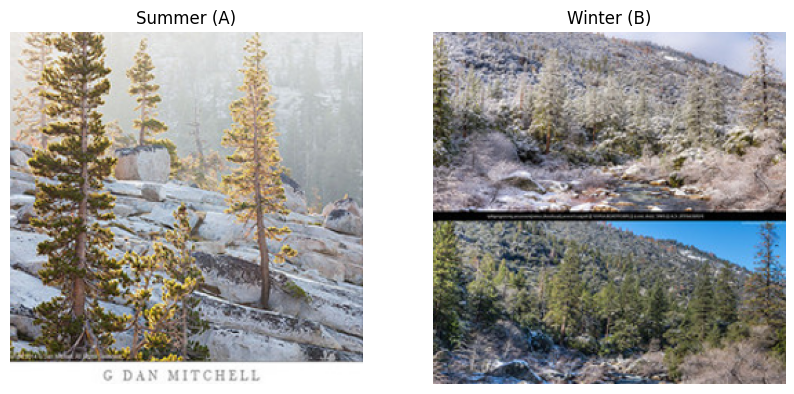

In [ ]:
batch = next(iter(train_loader_cycle))
plt.figure(figsize=(10, 5))
plt.subplot(1, 2, 1)
plt.title("Summer (A)")
plt.axis("off")
plt.imshow(np.transpose(vutils.make_grid(batch['A'], normalize=True).cpu(), (1, 2, 0)))
plt.subplot(1, 2, 2)
plt.title("Winter (B)")
plt.axis("off")
plt.imshow(np.transpose(vutils.make_grid(batch['B'], normalize=True).cpu(), (1, 2, 0)))
plt.show()

In [ ]:
4

In [ ]:
import torch
import torch.nn as nn
import torch.optim as optim
import torchvision.utils as vutils
import numpy as np
import matplotlib.pyplot as plt

In [ ]:
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
def weights_init(m):
    classname = m.__class__.__name__
    if classname.find('Conv') != -1:
        nn.init.normal_(m.weight.data, 0.0, 0.02)
        if hasattr(m, 'bias') and m.bias is not None:
            nn.init.constant_(m.bias.data, 0)

    elif classname.find('InstanceNorm') != -1:
        if m.weight is not None and m.bias is not None:
            nn.init.normal_(m.weight.data, 1.0, 0.02)
            nn.init.constant_(m.bias.data, 0)

    elif classname.find('BatchNorm') != -1:
        nn.init.normal_(m.weight.data, 1.0, 0.02)
        nn.init.constant_(m.bias.data, 0)

In [ ]:
class ResidualBlock(nn.Module):
    def __init__(self, in_features):
        super(ResidualBlock, self).__init__()
        self.block = nn.Sequential(
            nn.ReflectionPad2d(1),
            nn.Conv2d(in_features, in_features, 3),
            nn.InstanceNorm2d(in_features),
            nn.ReLU(inplace=True),
            nn.ReflectionPad2d(1),
            nn.Conv2d(in_features, in_features, 3),
            nn.InstanceNorm2d(in_features)
        )

    def forward(self, x):
        return x + self.block(x)

In [ ]:
class CycleGenerator(nn.Module):
    def __init__(self, input_shape=(3, 256, 256), num_residual_blocks=9):
        super(CycleGenerator, self).__init__()
        channels = input_shape[0]
        model = [
            nn.ReflectionPad2d(3),
            nn.Conv2d(channels, 64, 7),
            nn.InstanceNorm2d(64),
            nn.ReLU(inplace=True)
        ]

        in_features = 64
        out_features = in_features * 2
        for _ in range(2):
            model += [
                nn.Conv2d(in_features, out_features, 3, stride=2, padding=1),
                nn.InstanceNorm2d(out_features),
                nn.ReLU(inplace=True)
            ]
            in_features = out_features
            out_features = in_features * 2

        for _ in range(num_residual_blocks):
            model += [ResidualBlock(in_features)]

        out_features = in_features // 2
        for _ in range(2):
            model += [
                nn.ConvTranspose2d(in_features, out_features, 3, stride=2, padding=1, output_padding=1),
                nn.InstanceNorm2d(out_features),
                nn.ReLU(inplace=True)
            ]
            in_features = out_features
            out_features = in_features // 2

        model += [
            nn.ReflectionPad2d(3),
            nn.Conv2d(64, channels, 7),
            nn.Tanh()
        ]

        self.model = nn.Sequential(*model)

    def forward(self, x):
        return self.model(x)

In [ ]:
class CycleDiscriminator(nn.Module):
    def __init__(self, input_shape=(3, 256, 256)):
        super(CycleDiscriminator, self).__init__()
        channels, height, width = input_shape

        def discriminator_block(in_filters, out_filters, normalize=True):
            layers = [nn.Conv2d(in_filters, out_filters, 4, stride=2, padding=1)]
            if normalize:
                layers.append(nn.InstanceNorm2d(out_filters))
            layers.append(nn.LeakyReLU(0.2, inplace=True))
            return layers

        self.model = nn.Sequential(
            *discriminator_block(channels, 64, normalize=False),
            *discriminator_block(64, 128),
            *discriminator_block(128, 256),
            *discriminator_block(256, 512),
            nn.ZeroPad2d((1, 0, 1, 0)),
            nn.Conv2d(512, 1, 4, padding=1)
        )

    def forward(self, img):
        return self.model(img)

In [ ]:
G_AB = CycleGenerator().to(device)
G_BA = CycleGenerator().to(device)
D_A = CycleDiscriminator().to(device)
D_B = CycleDiscriminator().to(device)

In [ ]:
G_AB.apply(weights_init)
G_BA.apply(weights_init)
D_A.apply(weights_init)
D_B.apply(weights_init)

CycleDiscriminator(
  (model): Sequential(
    (0): Conv2d(3, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1))
    (1): LeakyReLU(negative_slope=0.2, inplace=True)
    (2): Conv2d(64, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1))
    (3): InstanceNorm2d(128, eps=1e-05, momentum=0.1, affine=False, track_running_stats=False)
    (4): LeakyReLU(negative_slope=0.2, inplace=True)
    (5): Conv2d(128, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1))
    (6): InstanceNorm2d(256, eps=1e-05, momentum=0.1, affine=False, track_running_stats=False)
    (7): LeakyReLU(negative_slope=0.2, inplace=True)
    (8): Conv2d(256, 512, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1))
    (9): InstanceNorm2d(512, eps=1e-05, momentum=0.1, affine=False, track_running_stats=False)
    (10): LeakyReLU(negative_slope=0.2, inplace=True)
    (11): ZeroPad2d((1, 0, 1, 0))
    (12): Conv2d(512, 1, kernel_size=(4, 4), stride=(1, 1), padding=(1, 1))
  )
)

In [ ]:
criterion_GAN = nn.MSELoss()
criterion_cycle = nn.L1Loss()
criterion_identity = nn.L1Loss()

In [ ]:
optimizer_G = optim.Adam(list(G_AB.parameters()) + list(G_BA.parameters()), lr=0.0002, betas=(0.5, 0.999))
optimizer_D_A = optim.Adam(D_A.parameters(), lr=0.0002, betas=(0.5, 0.999))
optimizer_D_B = optim.Adam(D_B.parameters(), lr=0.0002, betas=(0.5, 0.999))

In [ ]:
lambda_GAN = 1.0
lambda_cycle = 5.0
lambda_identity = 0.5

In [ ]:
n_epochs = 10
print_every = 50

=== Начало обучения CycleGAN ===
Веса loss'ов: GAN=1.0, Cycle=5.0, Identity=0.5
Эпох: 10, Батчей: 1231

[Epoch 0/10] [Batch 0/1231]
  G_total: 10.2296 = GAN: 2.3922 + Cycle: 7.1221 + Identity: 0.7153
  D_A: 1.8415 | D_B: 2.1342
  Доли: GAN 23.4% | Cycle 69.6% | Identity 7.0%

[Epoch 0/10] [Batch 50/1231]
  G_total: 3.5422 = GAN: 0.4935 + Cycle: 2.7920 + Identity: 0.2567
  D_A: 0.3509 | D_B: 0.4506
  Доли: GAN 13.9% | Cycle 78.8% | Identity 7.2%

[Epoch 0/10] [Batch 100/1231]
  G_total: 4.0965 = GAN: 0.5202 + Cycle: 3.2753 + Identity: 0.3010
  D_A: 0.3179 | D_B: 0.2689
  Доли: GAN 12.7% | Cycle 80.0% | Identity 7.3%

[Epoch 0/10] [Batch 150/1231]
  G_total: 3.4625 = GAN: 0.2462 + Cycle: 2.9370 + Identity: 0.2793
  D_A: 0.2948 | D_B: 0.2478
  Доли: GAN 7.1% | Cycle 84.8% | Identity 8.1%

[Epoch 0/10] [Batch 200/1231]
  G_total: 4.7043 = GAN: 0.4490 + Cycle: 3.8878 + Identity: 0.3676
  D_A: 0.1906 | D_B: 0.2597
  Доли: GAN 9.5% | Cycle 82.6% | Identity 7.8%

[Epoch 0/10] [Batch 250/1231]


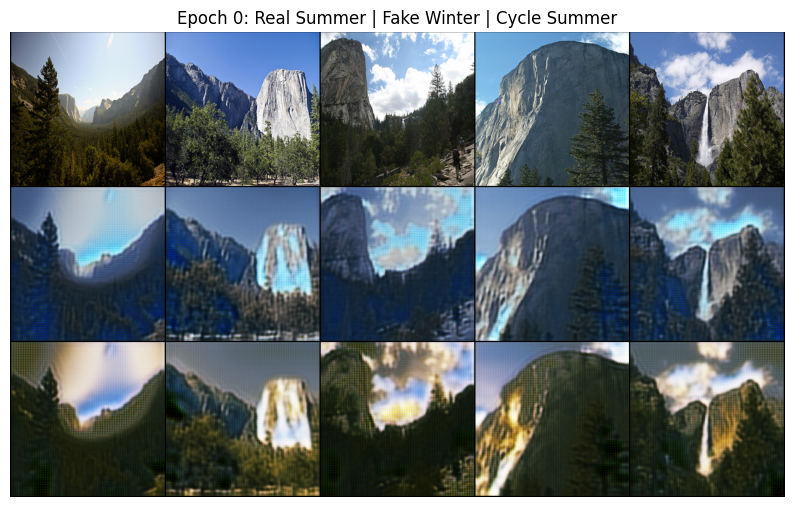

[Epoch 1/10] [Batch 0/1231]
  G_total: 3.5635 = GAN: 0.2590 + Cycle: 3.0840 + Identity: 0.2205
  D_A: 0.3669 | D_B: 0.2706
  Доли: GAN 7.3% | Cycle 86.5% | Identity 6.2%

[Epoch 1/10] [Batch 50/1231]
  G_total: 3.1136 = GAN: 0.3802 + Cycle: 2.4938 + Identity: 0.2396
  D_A: 0.2265 | D_B: 0.2204
  Доли: GAN 12.2% | Cycle 80.1% | Identity 7.7%

[Epoch 1/10] [Batch 100/1231]
  G_total: 2.6639 = GAN: 0.3234 + Cycle: 2.1576 + Identity: 0.1829
  D_A: 0.2589 | D_B: 0.4357
  Доли: GAN 12.1% | Cycle 81.0% | Identity 6.9%

[Epoch 1/10] [Batch 150/1231]
  G_total: 3.1591 = GAN: 0.4475 + Cycle: 2.4804 + Identity: 0.2312
  D_A: 0.2274 | D_B: 0.1560
  Доли: GAN 14.2% | Cycle 78.5% | Identity 7.3%

[Epoch 1/10] [Batch 200/1231]
  G_total: 2.2149 = GAN: 0.4150 + Cycle: 1.6411 + Identity: 0.1588
  D_A: 0.3381 | D_B: 0.2655
  Доли: GAN 18.7% | Cycle 74.1% | Identity 7.2%

[Epoch 1/10] [Batch 250/1231]
  G_total: 3.8536 = GAN: 0.3782 + Cycle: 3.2173 + Identity: 0.2581
  D_A: 0.1591 | D_B: 0.4400
  Доли: G

In [ ]:
loss_history = {
    'G_total': [], 'GAN': [], 'Cycle': [], 'Identity': [],
    'D_A': [], 'D_B': []
}

print(f"=== Начало обучения CycleGAN ===")
print(f"Веса loss'ов: GAN={lambda_GAN}, Cycle={lambda_cycle}, Identity={lambda_identity}")
print(f"Эпох: {n_epochs}, Батчей: {len(train_loader_cycle)}\n")

for epoch in range(n_epochs):
    epoch_losses = {'G': [], 'GAN': [], 'Cycle': [], 'Identity': [], 'D_A': [], 'D_B': []}

    for i, batch in enumerate(train_loader_cycle):
        real_A = batch['A'].to(device)
        real_B = batch['B'].to(device)

        valid = torch.ones_like(D_A(real_A), requires_grad=False).to(device)
        fake = torch.zeros_like(D_A(real_A), requires_grad=False).to(device)

        G_AB.train()
        G_BA.train()
        optimizer_G.zero_grad()

        fake_B = G_AB(real_A)
        loss_GAN_AB = criterion_GAN(D_B(fake_B), valid)

        fake_A = G_BA(real_B)
        loss_GAN_BA = criterion_GAN(D_A(fake_A), valid)

        loss_GAN = (loss_GAN_AB + loss_GAN_BA) / 2 * lambda_GAN

        recov_A = G_BA(fake_B)
        loss_cycle_A = criterion_cycle(recov_A, real_A) * lambda_cycle

        recov_B = G_AB(fake_A)
        loss_cycle_B = criterion_cycle(recov_B, real_B) * lambda_cycle

        loss_cycle = loss_cycle_A + loss_cycle_B

        loss_id_A = criterion_identity(G_BA(real_A), real_A) * lambda_identity
        loss_id_B = criterion_identity(G_AB(real_B), real_B) * lambda_identity
        loss_identity = loss_id_A + loss_id_B

        loss_G = loss_GAN + loss_cycle + loss_identity
        loss_G.backward()
        optimizer_G.step()

        optimizer_D_A.zero_grad()
        loss_real = criterion_GAN(D_A(real_A), valid)
        loss_fake = criterion_GAN(D_A(fake_A.detach()), fake)
        loss_D_A = (loss_real + loss_fake) / 2
        loss_D_A.backward()
        optimizer_D_A.step()

        optimizer_D_B.zero_grad()
        loss_real = criterion_GAN(D_B(real_B), valid)
        loss_fake = criterion_GAN(D_B(fake_B.detach()), fake)
        loss_D_B = (loss_real + loss_fake) / 2
        loss_D_B.backward()
        optimizer_D_B.step()

        epoch_losses['G'].append(loss_G.item())
        epoch_losses['GAN'].append(loss_GAN.item())
        epoch_losses['Cycle'].append(loss_cycle.item())
        epoch_losses['Identity'].append(loss_identity.item())
        epoch_losses['D_A'].append(loss_D_A.item())
        epoch_losses['D_B'].append(loss_D_B.item())

        if i % print_every == 0:
            print(f"[Epoch {epoch}/{n_epochs}] [Batch {i}/{len(train_loader_cycle)}]")
            print(f"  G_total: {loss_G.item():.4f} = GAN: {loss_GAN.item():.4f} + Cycle: {loss_cycle.item():.4f} + Identity: {loss_identity.item():.4f}")
            print(f"  D_A: {loss_D_A.item():.4f} | D_B: {loss_D_B.item():.4f}")

            total = loss_GAN.item() + loss_cycle.item() + loss_identity.item()
            if total > 0:
                gan_pct = (loss_GAN.item() / total) * 100
                cycle_pct = (loss_cycle.item() / total) * 100
                identity_pct = (loss_identity.item() / total) * 100
                print(f"  Доли: GAN {gan_pct:.1f}% | Cycle {cycle_pct:.1f}% | Identity {identity_pct:.1f}%")
            print()

    avg_G = np.mean(epoch_losses['G'])
    avg_GAN = np.mean(epoch_losses['GAN'])
    avg_Cycle = np.mean(epoch_losses['Cycle'])
    avg_Identity = np.mean(epoch_losses['Identity'])
    avg_D_A = np.mean(epoch_losses['D_A'])
    avg_D_B = np.mean(epoch_losses['D_B'])

    print(f"{'='*70}")
    print(f"ЭПОХА {epoch} ЗАВЕРШЕНА | Средние значения:")
    print(f"  G_total: {avg_G:.4f} = GAN: {avg_GAN:.4f} + Cycle: {avg_Cycle:.4f} + Identity: {avg_Identity:.4f}")
    print(f"  D_A: {avg_D_A:.4f} | D_B: {avg_D_B:.4f}")
    print(f"{'='*70}\n")


    with torch.no_grad():
        G_AB.eval()
        G_BA.eval()

        test_batch = next(iter(test_loader_cycle))
        real_A = test_batch['A'].to(device)
        fake_B = G_AB(real_A)
        recov_A = G_BA(fake_B)

        img_sample = torch.cat((real_A, fake_B, recov_A), 0)

        plt.figure(figsize=(10, 8))
        plt.axis("off")
        plt.title(f"Epoch {epoch}: Real Summer | Fake Winter | Cycle Summer")
        plt.imshow(np.transpose(vutils.make_grid(img_sample, nrow=5, padding=2, normalize=True).cpu(), (1,2,0)))
        plt.show()